# meteoblue python measurements demo

meteoblue collects public third parties measurements in a dedicated database, accessible via a (prototype) [user interface](https://measurements.meteoblue.io/measurements-ui/#/map?providers=metOffice) or directly from Python environment using the meteoblue [Python dataset SDK](https://github.com/meteoblue/python-dataset-sdk). 

This notebook assumes you have a list called `station_selection.csv` that specifies a number of station metadata (especially the id and the provider) in the same directory. Such a selection of stations meeting specified criteria (e.g. within specific geographic extent, more than a specific number of measurements, ...) can be easily retrieved using the user interface.  
With such a list we can easily retrieve data of multiple stations at once using the dataset SDK and convert it to a pandas dataframe. Processing this data is then really straightforward. Also we can easily pull in NWP model data at the station locations and then compare modeled and measured values. 

In [1]:
import os
import zlib
import meteoblue_dataset_sdk
from meteoblue_dataset_sdk.caching import FileCache
import pandas as pd
import numpy as np
import dateutil.parser
import matplotlib.pyplot as plt
import matplotlib as mpl
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import cartopy.io.img_tiles as img_tiles
%matplotlib inline

In [2]:
# utility functions and initial setup

# cache downlaoded mb data for 1 day (86400 seconds)
cache = FileCache(path="./mb_cache", max_age=86400, compression_level=zlib.Z_BEST_SPEED)
# initialize the client for querying mb data
client = meteoblue_dataset_sdk.Client(apikey=os.environ["APIKEY"], cache=cache) # apikey has to be saved in your environment
# higher quality when plotting with plt
plt.rcParams['figure.dpi'] = 300

def map_ts(time):
    if "-" not in time:
        return time
    return dateutil.parser.parse(time.partition("-")[0])

def meteoblue_timeinterval_to_timestamps(t):
    if len(t.timestrings) > 0:
        return list(map(map_ts, t.timestrings))

    timerange = range(t.start, t.end, t.stride)
    return list(timerange)

def meteoblue_result_to_dataframe(geometry):
    t = geometry.timeIntervals[0]
    timestamps = meteoblue_timeinterval_to_timestamps(t)

    n_locations = len(geometry.lats)
    n_timesteps = len(timestamps)

    df = pd.DataFrame(
        {
            "timestamp": np.tile(timestamps, n_locations),
            "id": np.repeat(geometry.locationNames, n_timesteps),
            "Longitude": np.repeat(geometry.lons, n_timesteps),
            "Latitude": np.repeat(geometry.lats, n_timesteps),
            "Elevation": np.repeat(geometry.asls, n_timesteps),
        }
    )

    for code in geometry.codes:
        name = str(code.code) + "_" + code.level + "_" + code.aggregation
        df[name] = code.timeIntervals[0].data
    return df

def measurements_to_dataframe(measurements):
    df = pd.DataFrame()
    for col in measurements.columns:
        name = str(col.column) 
        col_type = col.values.WhichOneof("oneof_values")
        if col_type == "strings":
            df[name] = col.values.strings.array
        elif col_type == "floats":
            df[name] = col.values.floats.array
        elif col_type == "ints64":
            df[name] = col.values.ints64.array
    return df

def rmse(df, name1, name2):
    rmse = np.sqrt(((df[name1] - df[name2])**2).mean())
    return rmse

def mae(df, name1, name2):
    mae = (np.abs(df[name1] - df[name2])).mean()
    return mae

def corr_pearsonr(df, name1, name2):
    # remove missing values
    nan_mask = ~(np.isnan(df[name1]) | np.isnan(df[name2]))
    corr = np.corrcoef(df[name1][nan_mask], df[name2][nan_mask])
    return corr[0, 1] # Pearson R is equal to non diagonal elements

def first_non_nan(series):
    return series[np.isfinite(series)][0]

## Query measurement data using a list of stations

Assume we have downloaded a `station_selection.csv` specifying the station ids and meta information (such as lat, lon, asl) for multiple stations. We use this file to request temperature time series for October 2021 for multiple stations.

In [3]:
stations_df = pd.read_csv("station_selection.csv")

def configure_measurement_query_for_provider(provider, name_variable_measured, stations):
    
    # query measurement data for time interval
    path = f"/rawdata/{provider}/{provider}Measurement/get"
    name_variable_measured = "temperature_unknown_atTimestamp_none_degCels"
    query = {
        "timeStart": "2021-10-01T00:00:00",
        "timeEnd": "2021-10-31T23:00:00",
        "limit": 100000,
        "fields": [
            "id",
            "timestamp",
            "lat",
            "lon",
            "asl",
            name_variable_measured
        ],
        "stations": stations,
        "sort": "asc"
        }
    return path, query

name_variable_measured = "temperature_unknown_atTimestamp_none_degCels"


# query data for synop
path, query = configure_measurement_query_for_provider(
    provider="synop", 
    name_variable_measured=name_variable_measured, 
    stations=list(stations_df[stations_df.Provider == "synop"]["Station ID"].values)
)
synop_df = measurements_to_dataframe(
    client.measurement_sync(path, query)
)
# query data for metar
path, query = configure_measurement_query_for_provider(
    provider="metar", 
    name_variable_measured=name_variable_measured, 
    stations=list(stations_df[stations_df.Provider == "metar"]["Station ID"].values)
)
metar_df = measurements_to_dataframe(
    client.measurement_sync(path, query)
)


In [4]:
synop_df

,id,timestamp,lat,lon,asl,temperature_unknown_atTimestamp_none_degCels
0,14010,1633046400,46.366699,14.1833,515.0,9.6
1,14012,1633046400,46.099998,14.3667,685.0,9.9
2,14021,1633046400,46.483299,15.1167,452.0,7.8
3,14023,1633046400,46.250000,15.2500,244.0,7.0
4,14112,1633046400,45.766701,14.2000,533.0,9.2
...,...,...,...,...,...,...
4630,14024,1635714000,46.066700,15.2833,943.0,7.6
4631,14026,1635714000,46.483299,15.6833,264.0,8.1
4632,14105,1635714000,45.483299,13.6167,2.0,10.3
4633,14106,1635714000,45.900002,13.6333,55.0,7.5


In [5]:
# merge dataframes of synop and metar and resample temperature timeseries to 3hourly data
# generally one should be careful when doing such things
# but since lat, lon, asl are unique per group taking the mean is okay
# and effectively yields only the average of temperature measurements!
measurements_df = pd.concat([metar_df, synop_df])
measurements_df["timestamp"] = pd.to_datetime(measurements_df["timestamp"], unit="s").dt.floor("3H")
measurements_df = measurements_df.groupby(["id", "timestamp"]).mean()
measurements_df = measurements_df.reset_index()
measurements_df

,id,timestamp,lat,lon,asl,temperature_unknown_atTimestamp_none_degCels
0,14006,2021-10-01 00:00:00,46.266701,13.8333,1535.0,4.100000
1,14006,2021-10-01 03:00:00,46.266701,13.8333,1535.0,1.500000
2,14006,2021-10-01 06:00:00,46.266701,13.8333,1535.0,4.400000
3,14006,2021-10-01 09:00:00,46.266701,13.8333,1535.0,7.400000
4,14006,2021-10-01 15:00:00,46.266701,13.8333,1535.0,8.900000
...,...,...,...,...,...,...
5622,LJPZ,2021-10-31 09:00:00,45.470001,13.6200,2.0,15.833333
5623,LJPZ,2021-10-31 12:00:00,45.470001,13.6200,2.0,16.000000
5624,LJPZ,2021-10-31 15:00:00,45.470001,13.6200,2.0,13.166667
5625,LJPZ,2021-10-31 18:00:00,45.470001,13.6200,2.0,10.200000


Calculate monthly average temperatures of the timeseries:

In [6]:
measurements_df["month"] = measurements_df["timestamp"].dt.to_period('M').dt.to_timestamp()
measurements_grouped = measurements_df.groupby(["id", "month"])
averages_df = measurements_grouped.mean()
averages_df

,,lat,lon,asl,temperature_unknown_atTimestamp_none_degCels
id,month,,,,
14006,2021-10-01,46.266701,13.8333,1535.0,4.385950
14007,2021-10-01,46.500000,13.7167,864.0,6.464609
14008,2021-10-01,46.383301,13.8500,2514.0,0.163180
14009,2021-10-01,46.033298,13.9000,1067.0,7.012069
14010,2021-10-01,46.366699,14.1833,515.0,8.784711
14012,2021-10-01,46.099998,14.3667,685.0,8.814108
14014,2021-10-01,46.216702,14.4833,385.0,8.148548
14015,2021-10-01,46.066700,14.5167,299.0,9.700830
14021,2021-10-01,46.483299,15.1167,452.0,8.495397


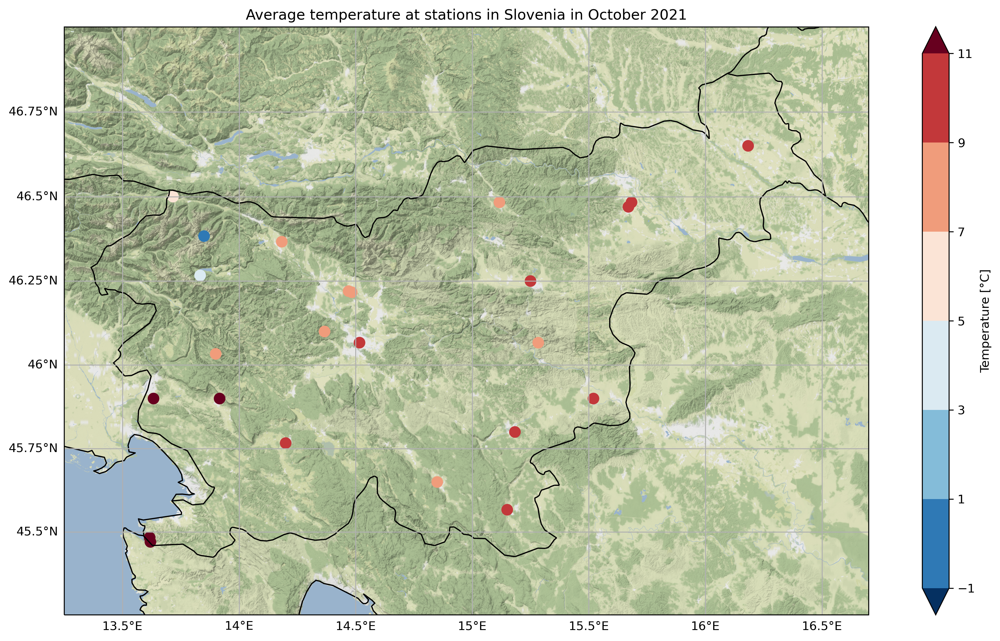

In [7]:
def plot_averages(averages_df, name_variable_measured):
    # plot stations in front of stamen background
    fig = plt.figure(figsize=(16,9))
    imagery = img_tiles.Stamen(style="terrain-background")
    ax = fig.add_subplot(1, 1, 1, projection=imagery.crs)
    ax.set_extent([13.25, 16.7, 45.25, 47.0], ccrs.Geodetic())
    # add the imagery to the map.
    ax.add_image(imagery, 12)
    
    # the values to plot
    lons = averages_df["lon"].values
    lats = averages_df["lat"].values
    temps = averages_df[name_variable_measured].values
    
    # gridlines
    gl = ax.gridlines(draw_labels=True)
    gl.top_labels = False
    gl.right_labels = False
    
    cmap = plt.cm.get_cmap('RdBu_r')
    bounds = [-1, 1, 3, 5, 7, 9, 11]
    norm = mpl.colors.BoundaryNorm(bounds, cmap.N, extend='both')
    
    # ploat lat, lon and average temps
    sc = ax.scatter(lons, lats, c=temps, transform=ccrs.Geodetic(), s=75, cmap=cmap, norm=norm)
    cb = fig.colorbar(sc, ax=ax, orientation='vertical')
    cb.set_label("Temperature [°C]")
    
    # add country borders and coastlines
    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS)
    
    ax.set_title('Average temperature at stations in Slovenia in October 2021')
    plt.show()

    
plot_averages(averages_df, name_variable_measured)

### Compare with NWP model data

Using the meteoblue dataset sdk, we can easily pull in some NWP model data for the same timespan as the measurement data. 

In [8]:
coordinates = [[id_df.lon.values[0],id_df.lat.values[0],id_df.asl.values[0]] for _, id_df in measurements_grouped]
names = [ids[0] for ids, _ in measurements_grouped]

def query_for_lat_lon_asl_id(coordinates, ids):
    return {
        "units": {
            "temperature": "C",
            "velocity": "m/s",
            "length": "metric",
            "energy": "watts",
        },
        "geometry": {
            "type": "MultiPoint",
            "coordinates": coordinates,
            "locationNames": ids,
        },
        "format": "protobuf",
        "timeIntervals": ["2021-10-01T+00:00/2021-10-31T+00:00"],
        "timeIntervalsAlignment": "none",
        "queries": [
            {
                "domain": "ICONEU",
                "gapFillDomain": None,
                "timeResolution": "3hourly",
                "codes": [
                    {
                        "code": 11,
                        "level": "2 m above gnd"
                    }
                ]
            }
        ],
    }

query = query_for_lat_lon_asl_id(coordinates, names)
result = client.query_sync(query)
model_df = meteoblue_result_to_dataframe(result.geometries[0])
model_df

,timestamp,id,Longitude,Latitude,Elevation,11_2 m above gnd_none
0,1633046400,14006,13.750,46.3125,1655.875244,5.09
1,1633057200,14006,13.750,46.3125,1655.875244,4.78
2,1633068000,14006,13.750,46.3125,1655.875244,5.56
3,1633078800,14006,13.750,46.3125,1655.875244,10.09
4,1633089600,14006,13.750,46.3125,1655.875244,10.79
...,...,...,...,...,...,...
5947,1635670800,LJPZ,13.625,45.5000,72.875244,15.43
5948,1635681600,LJPZ,13.625,45.5000,72.875244,16.27
5949,1635692400,LJPZ,13.625,45.5000,72.875244,14.86
5950,1635703200,LJPZ,13.625,45.5000,72.875244,12.65


Merge model data to the measurement dataframe:

In [9]:
model_df["timestamp"] = pd.to_datetime(model_df["timestamp"], unit="s")
merged_df = pd.merge(
    measurements_df, 
    model_df, 
    how="outer", 
    left_on=["id", "timestamp"], 
    right_on = ["id", "timestamp"]
)
merged_df = merged_df.sort_values("timestamp")
merged_df

,id,timestamp,lat,lon,asl,temperature_unknown_atTimestamp_none_degCels,month,Longitude,Latitude,Elevation,11_2 m above gnd_none
0,14006,2021-10-01 00:00:00,46.266701,13.8333,1535.0,4.100000,2021-10-01,13.7500,46.3125,1655.875244,5.09
2713,14031,2021-10-01 00:00:00,46.650002,16.1833,188.0,7.500000,2021-10-01,16.1875,46.6250,191.750244,8.77
4883,LJLJ,2021-10-01 00:00:00,46.220001,14.4700,363.0,6.666667,2021-10-01,14.4375,46.1875,358.875244,9.28
3192,14106,2021-10-01 00:00:00,45.900002,13.6333,55.0,16.000000,2021-10-01,13.6250,45.8750,196.875244,11.71
2474,14026,2021-10-01 00:00:00,46.483299,15.6833,264.0,7.000000,2021-10-01,15.6875,46.5000,317.375244,9.84
...,...,...,...,...,...,...,...,...,...,...,...
1746,14015,2021-10-31 21:00:00,46.066700,14.5167,299.0,7.100000,2021-10-01,14.5000,46.0625,300.250244,5.70
5626,LJPZ,2021-10-31 21:00:00,45.470001,13.6200,2.0,10.200000,2021-10-01,13.6250,45.5000,72.875244,11.22
5378,LJMB,2021-10-31 21:00:00,46.470001,15.6700,263.0,8.600000,2021-10-01,15.6875,46.5000,317.375244,6.56
3672,14112,2021-10-31 21:00:00,45.766701,14.2000,533.0,7.600000,2021-10-01,14.1875,45.7500,596.500244,6.75


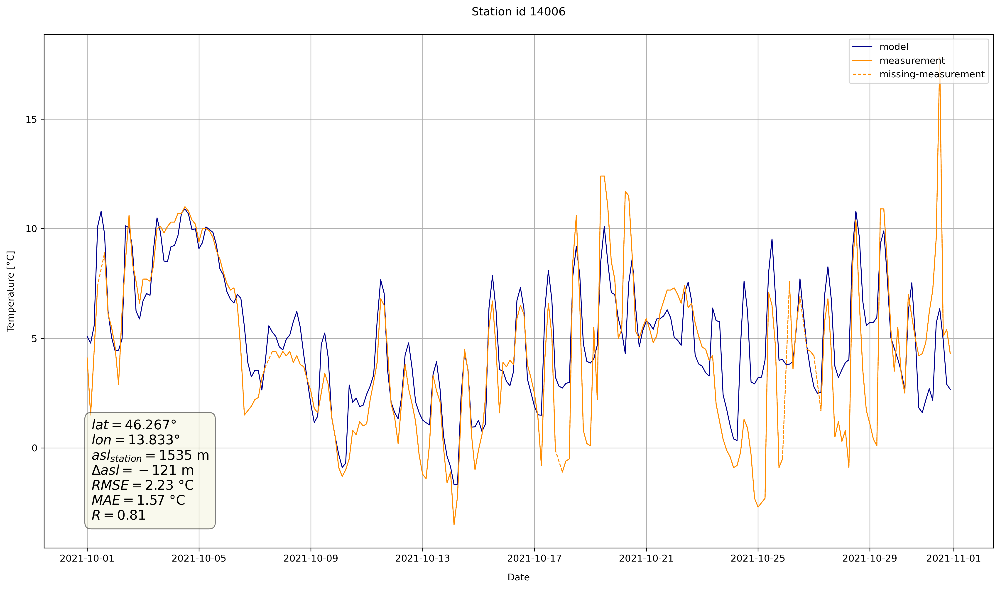

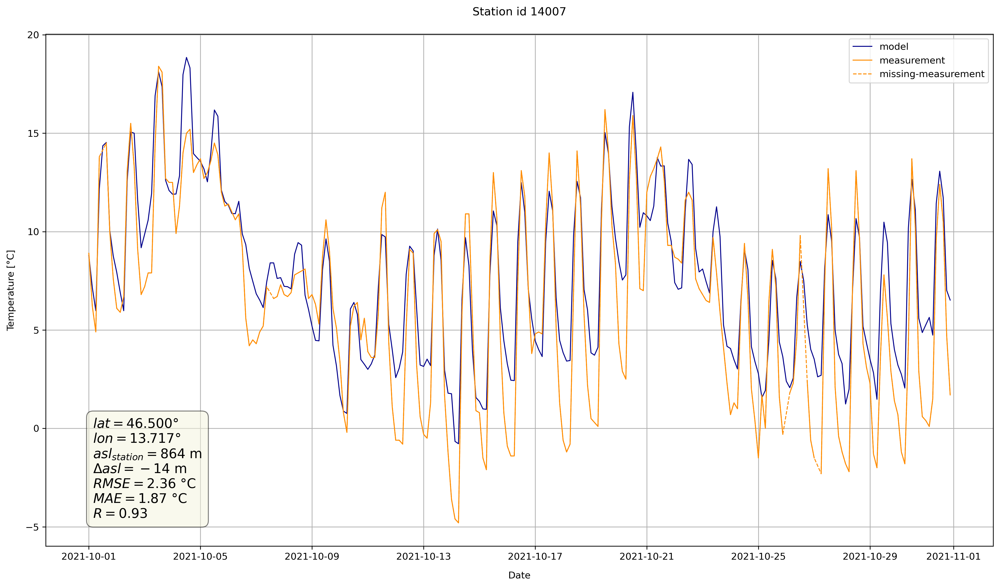

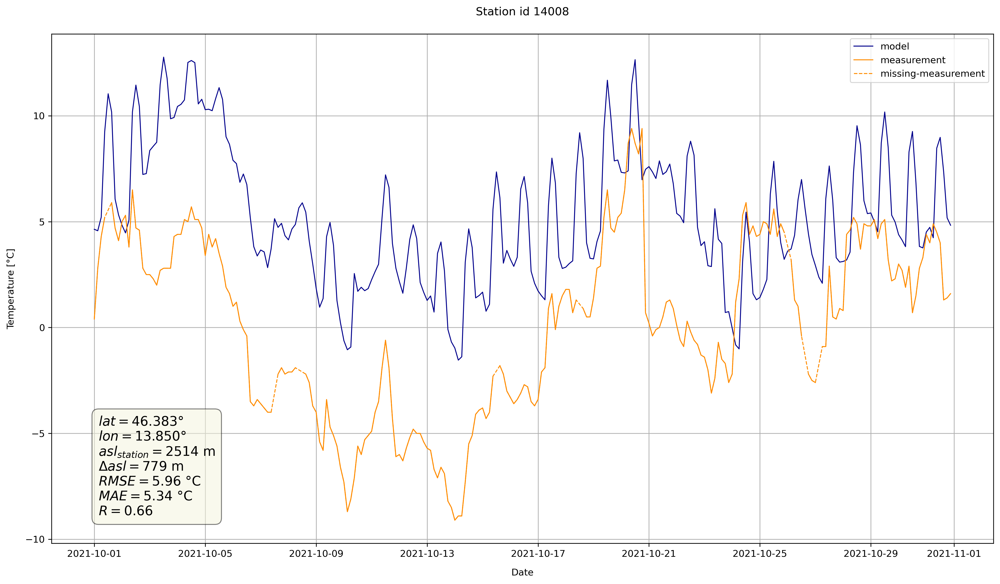

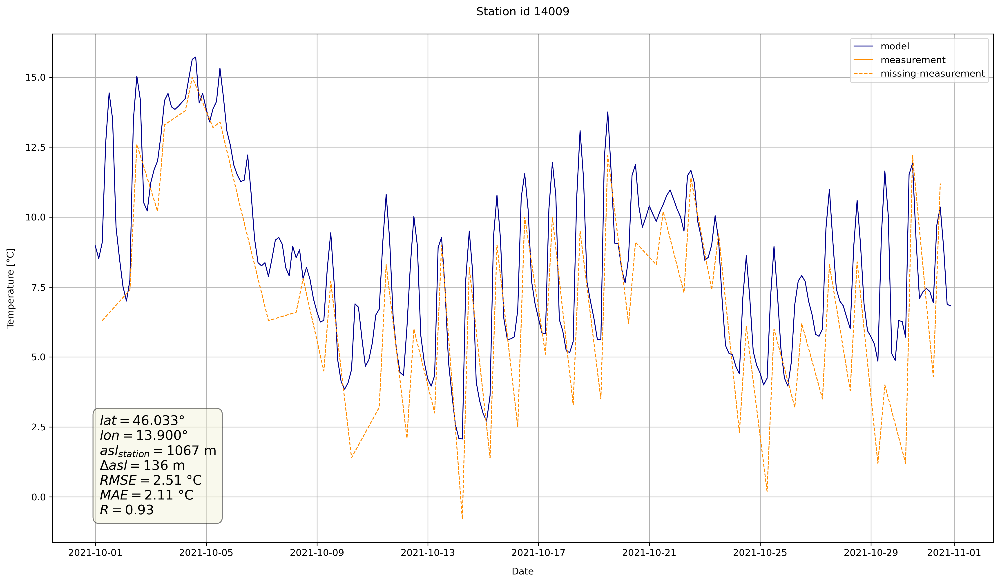

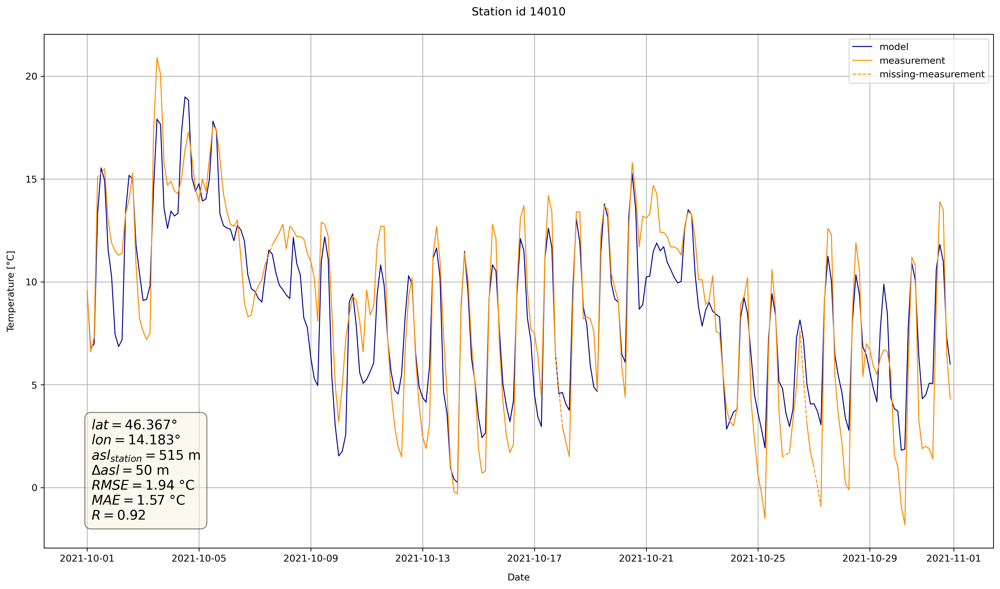

...

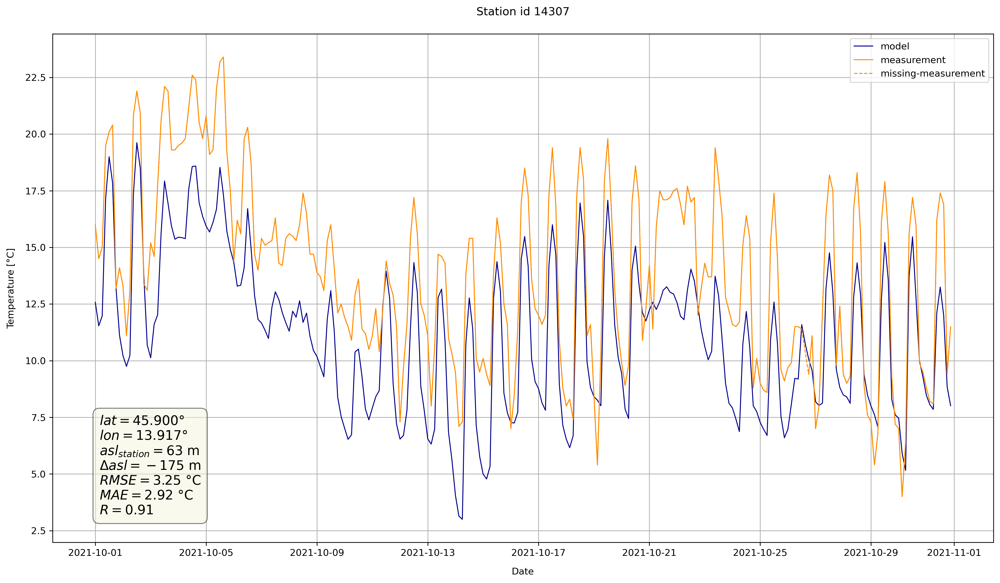

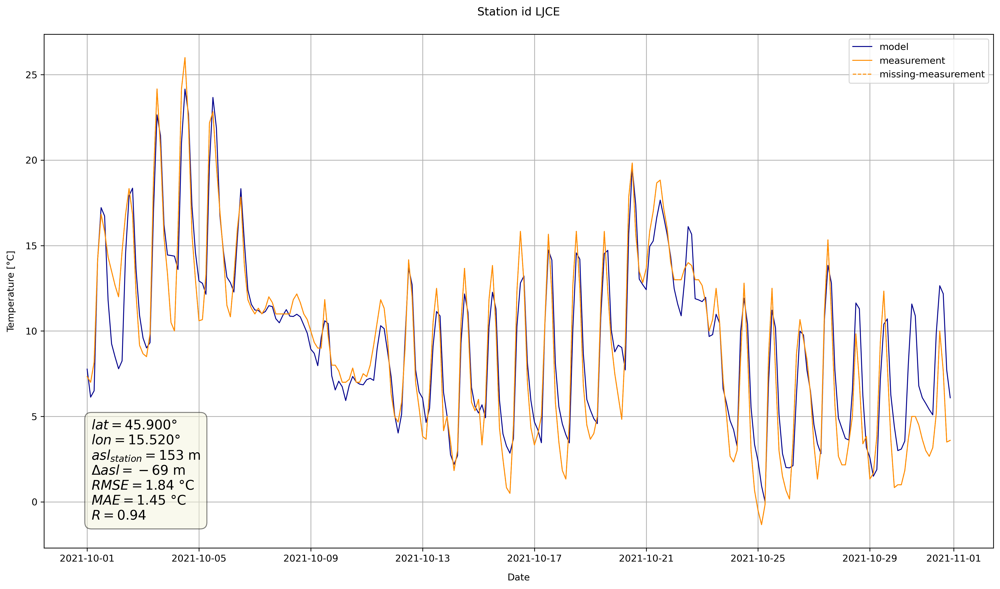

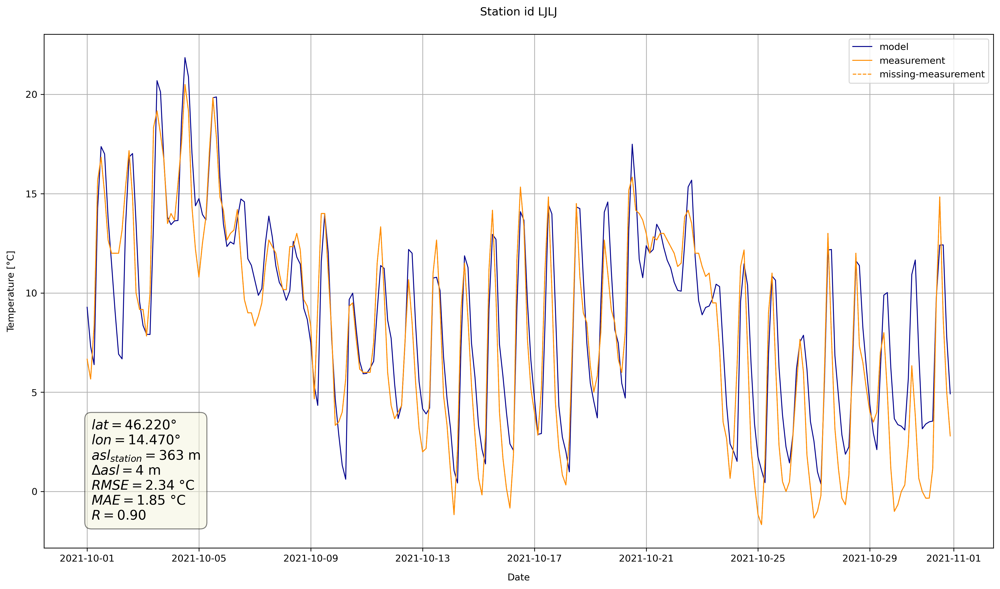

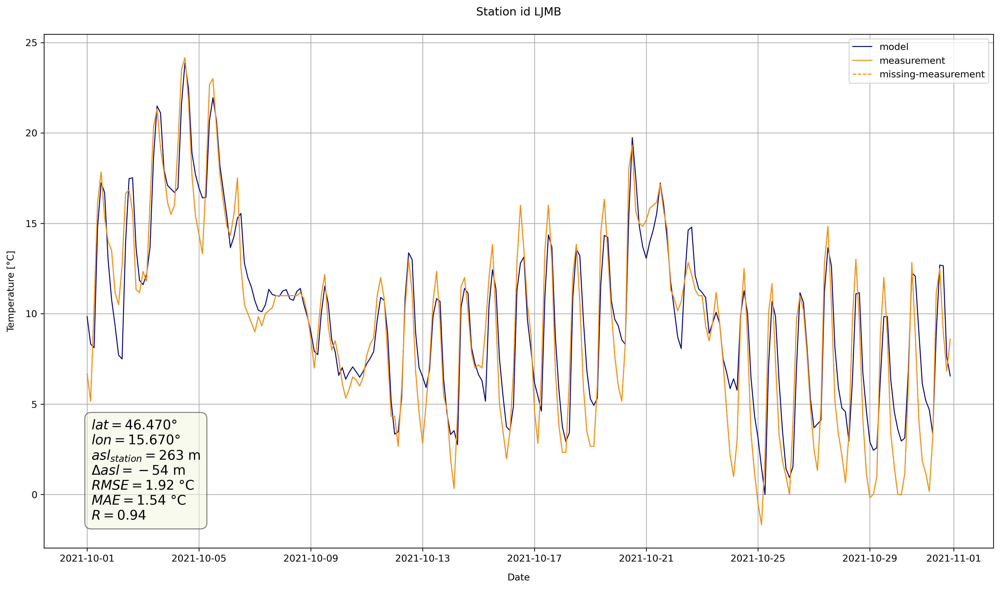

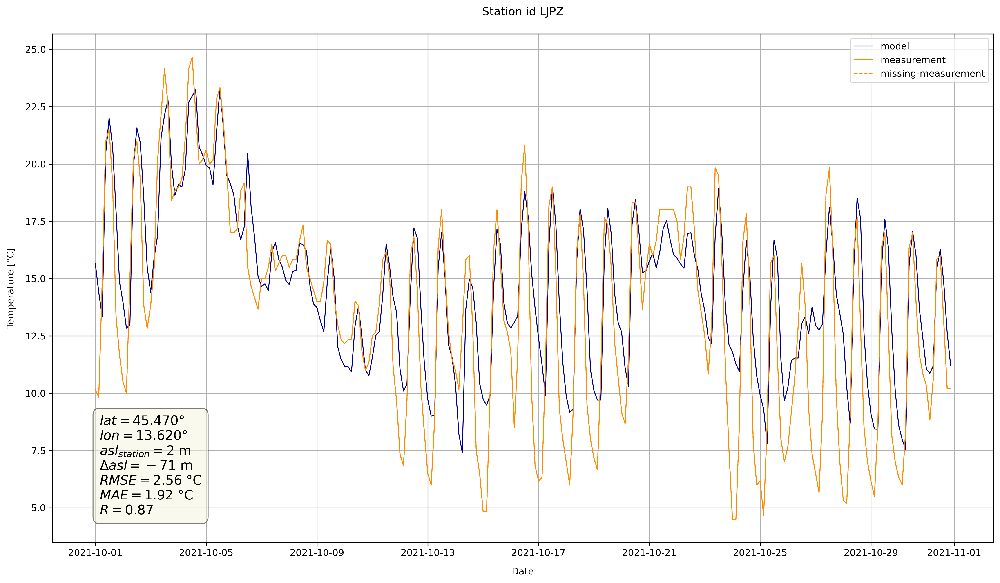

In [10]:
name_variable_modeled = "11_2 m above gnd_none"

def compare_measurement_model(merged_df):
    fig, ax = plt.subplots(figsize=(18, 10))
    plt.ylabel("Temperature [°C]", labelpad=10)
    plt.xlabel("Date", labelpad=10)
    # plot model data
    ax.plot(
        merged_df["timestamp"],
        merged_df[name_variable_modeled],
        color="darkblue",
        linewidth=1,
        label="model",
    )
    # plot measurement data
    ax.plot(
        merged_df["timestamp"],
        merged_df[name_variable_measured],
        color="darkorange",
        linewidth=1,
        label="measurement",
    )
    # plot a line for missing measurements as well
    mask = np.isfinite(merged_df[name_variable_measured])
    ax.plot(
        merged_df["timestamp"][mask],
        merged_df[name_variable_measured][mask],
        color="darkorange",
        ls="--",
        lw=1,
        label="missing-measurement",
    )
    id_val = merged_df["id"].values[0]
    # we might have missing values in the measured data (as a results of the outer join)
    lat_val = first_non_nan(merged_df["lat"].values)
    lon_val = first_non_nan(merged_df["lon"].values)
    asl_val = first_non_nan(merged_df["asl"].values)
    asl_diff = asl_val - merged_df["Elevation"].values[0]
    rmse_error = rmse(merged_df, name_variable_modeled, name_variable_measured)
    mae_error = mae(merged_df, name_variable_modeled, name_variable_measured)
    pearson_r = corr_pearsonr(merged_df, name_variable_modeled, name_variable_measured)
    textstr = "\n".join(
        (
            r"$lat= %.3f$°" % (lat_val,),
            r"$lon= %.3f$°" % (lon_val,),
            r"$asl_{station}= %.0f$ m" % (asl_val,),
            r"$\Delta asl=%.0f$ m" % (asl_diff,),
            r"$RMSE=%.2f$ °C" % (rmse_error,),
            r"$MAE=%.2f$ °C" % (mae_error,),
            r"$R=%.2f$" % (pearson_r,),
        )
    )
    # these are matplotlib.patch.Patch properties
    props = dict(
        boxstyle="round,pad=0.5", facecolor="beige", alpha=0.5, edgecolor="black"
    )

    # place a text box in lower left in axes coords
    ax.text(
        0.05,
        0.05,
        textstr,
        transform=ax.transAxes,
        fontsize=14,
        verticalalignment="bottom",
        bbox=props,
    )
    plt.legend(loc="upper right")
    plt.title(f"Station id {id_val}", pad=20)
    plt.grid(True)
    # plt.savefig(f"output/compare_{id_val}.png")
    plt.show()
    plt.close()
    
# group df and loop over single groups
grouped_df = merged_df.groupby("id")

for id, id_df in grouped_df:
    compare_measurement_model(id_df)
    